In [2]:
from sklearn.metrics import log_loss
import numpy as np
import pandas as pd
import matplotlib.pylab as plt
plt.style.use('ggplot')
from IPython.display import Video
from IPython.display import HTML
import sys
import os
sys.path.append("..")
print(sys.path)
import insightface
import cv2
import matplotlib.pylab as plt
import face_recognition
from tqdm import tqdm
from PIL import Image, ImageDraw
from skvideo.io import vread
from insightface.app.face_analysis import  Face
import random

['/home/kailu/deepfake/preprocess', '/home/kailu/.conda/envs/wukailu/lib/python37.zip', '/home/kailu/.conda/envs/wukailu/lib/python3.7', '/home/kailu/.conda/envs/wukailu/lib/python3.7/lib-dynload', '', '/home/kailu/.conda/envs/wukailu/lib/python3.7/site-packages', '/home/kailu/.conda/envs/wukailu/lib/python3.7/site-packages/googledrivedownloader-0.4-py3.7.egg', '/home/kailu/.conda/envs/wukailu/lib/python3.7/site-packages/rdflib-4.2.2-py3.7.egg', '/home/kailu/.conda/envs/wukailu/lib/python3.7/site-packages/plyfile-0.7.1-py3.7.egg', '/home/kailu/.conda/envs/wukailu/lib/python3.7/site-packages/isodate-0.6.0-py3.7.egg', '/home/kailu/.conda/envs/wukailu/lib/python3.7/site-packages/torch_geometric-1.3.2-py3.7.egg', '/home/kailu/.conda/envs/wukailu/lib/python3.7/site-packages/dlib-19.19.99-py3.7-linux-x86_64.egg', '/home/kailu/.conda/envs/wukailu/lib/python3.7/site-packages/IPython/extensions', '/home/kailu/.ipython', '..']


In [3]:
train_dir = "/data1/data/deepfake/dfdc_train"
face_cache = "/data/deepfake/faces"

train_sample_metadata = pd.read_json(os.path.join(train_dir,'metadata_all.json') ).T
train_sample_metadata.head()
indexes = train_sample_metadata[train_sample_metadata['label']=='REAL'].index

In [ ]:
train_sample_metadata.groupby('original')['original'].count().plot(figsize=(15, 5), kind='bar', title='Distribution of Labels in the Training Set')
plt.show()

# Deal with the case that there's more than 1 person in the video

* 有解近20%的视频有两张及以上的脸
* 视频生成方式是一个大视频切成多个10s小视频
* fake是每次iid sample一个真10s视频进行fake
* 对于两张脸以上的假视频，每帧会随机fake其中一张脸

In [20]:
'''
[Face(bbox=array([334.43234253, 155.82444763, 559.38562012, 469.98413086]), landmark=array([[419.0745 , 281.861  ],
        [515.15594, 269.66534],
        [499.31363, 323.17172],
        [453.2359 , 398.6037 ],
        [525.49915, 388.4388 ]], dtype=float32), det_score=0.9990795850753784, 
         embedding=array([-1.0620309e+00,  1.1161977e+00,  3.8892230e-01, -2.3631424e-01,
         ...
         5.4958087e-01, -3.7592593e-01, -9.0648293e-01, -8.5524321e-02],
         dtype=float32), gender=0, age=35, embedding_norm=22.439707, 
         normed_embedding=array([-4.73282002e-02,  4.97420803e-02,  1.73318796e-02, -1.05310753e-02,
         ...
         2.44914461e-02, -1.67527106e-02, -4.03963812e-02, -3.81129398e-03],
       dtype=float32))]

left, top, right, bottom
gender = 0 -> male
embedding is gen by arcface, dist measure is cos
use f=normed_embedding, np.sum(np.square(f1 - f2))
'''
# Fex = A.get(frames[0])

'\n[Face(bbox=array([334.43234253, 155.82444763, 559.38562012, 469.98413086]), landmark=array([[419.0745 , 281.861  ],\n        [515.15594, 269.66534],\n        [499.31363, 323.17172],\n        [453.2359 , 398.6037 ],\n        [525.49915, 388.4388 ]], dtype=float32), det_score=0.9990795850753784, \n         embedding=array([-1.0620309e+00,  1.1161977e+00,  3.8892230e-01, -2.3631424e-01,\n         ...\n         5.4958087e-01, -3.7592593e-01, -9.0648293e-01, -8.5524321e-02],\n         dtype=float32), gender=0, age=35, embedding_norm=22.439707, \n         normed_embedding=array([-4.73282002e-02,  4.97420803e-02,  1.73318796e-02, -1.05310753e-02,\n         ...\n         2.44914461e-02, -1.67527106e-02, -4.03963812e-02, -3.81129398e-03],\n       dtype=float32))]\n       \ngender = 0 -> male\nembedding is gen by arcface, dist measure is cos\nuse f=normed_embedding, np.sum(np.square(f1 - f2))\n'

# a trival split

In [3]:
def dist(emb1, emb2):
    return np.sum(np.square(emb1 - emb2))

def get_face_sub(index, emb_frames, gpu_id, process_id, face_detector, one_only = True):
    print("process id: ", process_id, "index :" , index)
    A = face_detector

    id2faces = dict()
    for fn in tqdm(index):
        label = train_sample_metadata.loc[fn]['label']
        orig = train_sample_metadata.loc[fn]['label']
        video_file = os.path.join(train_dir, fn)
        cap = cv.VideoCapture(video_file)

        frames = []
        while(cap.isOpened()):
            ret, frame = cap.read()
            if ret==True:
                frames.append(frame)
                if cv2.waitKey(1) & 0xFF == ord('q'):
                    break
            else:
                break
        cap.release()

        frame2faces = dict()
        for j in range(0, len(frames), emb_frames): # find face in one frame
            h, w = frames[j].shape[:2]
            frame = cv2.resize(frames[j], (w//2, h//2))
            face_list = A.get(frame)
            if len(face_list) == 0:
                print(f'Could not find face in frame {j} of {fn}')
                continue
            for idx, face in enumerate(face_list):
                face_list[idx] = face_list[idx]._replace(bbox = face_list[idx].bbox*2)._asdict()
            frame2faces[j]=face_list
            if one_only:
                break
        
        id2faces[fn] = frame2faces
    
    print(id2faces)
    return id2faces

def get_face_list(index, emb_frames = 10, gpu_id = -1):
    A = insightface.app.FaceAnalysis()
    A.prepare(gpu_id)
    return get_face_sub(index, emb_frames, gpu_id, 0, A)

# get_face_list(indexes[:10], gpu_id = -1, emb_frames = 10)

In [30]:

# temp = get_face_list_parall(train_sample_metadata[train_sample_metadata['label']=='REAL'].index[:2], gpu_ids = [0])
# temp = get_face_list(train_sample_metadata.index[1:2], gpu_id = -1, emb_frames = 10)
temp = get_face_list(indexes, gpu_id = 0, emb_frames = 15)

process id:  0 index : Index(['aayrffkzxn.mp4', 'apedduehoy.mp4', 'apvzjkvnwn.mp4', 'chqqxfuuzi.mp4',
       'ddtbarpcgo.mp4', 'dhjnjkzuhq.mp4', 'didzujjhtg.mp4', 'doniqevxeg.mp4',
       'dpevefkefv.mp4', 'dxfdovivlw.mp4',
       ...
       'znckxsojok.mp4', 'zpgqjxivpx.mp4', 'zpxirfbfiw.mp4', 'zpzycmsaik.mp4',
       'zsvfzkpjur.mp4', 'zuduvanawx.mp4', 'zwqdszjdop.mp4', 'zxafputanf.mp4',
       'zyeaapjwyg.mp4', 'zylribcaeu.mp4'],
      dtype='object', length=19154)
[32, 16, 8] {'32': {'SCALES': (32, 16), 'BASE_SIZE': 16, 'RATIOS': (1.0,), 'ALLOWED_BORDER': 9999}, '16': {'SCALES': (8, 4), 'BASE_SIZE': 16, 'RATIOS': (1.0,), 'ALLOWED_BORDER': 9999}, '8': {'SCALES': (2, 1), 'BASE_SIZE': 16, 'RATIOS': (1.0,), 'ALLOWED_BORDER': 9999}}
use_landmarks True


  2%|▏         | 302/19154 [10:21<9:58:58,  1.91s/it] 

Could not find face in frame 0 of nawtezpgnm.mp4


 16%|█▌        | 3039/19154 [1:34:46<8:17:00,  1.85s/it] 

Could not find face in frame 0 of lqxpsrkxzr.mp4
Could not find face in frame 15 of lqxpsrkxzr.mp4


 19%|█▉        | 3713/19154 [1:55:34<6:59:41,  1.63s/it]

Could not find face in frame 0 of iiuqymzjbp.mp4


 20%|██        | 3846/19154 [1:59:15<6:58:28,  1.64s/it]

Could not find face in frame 0 of qpmovegayu.mp4
Could not find face in frame 15 of qpmovegayu.mp4
Could not find face in frame 30 of qpmovegayu.mp4
Could not find face in frame 45 of qpmovegayu.mp4
Could not find face in frame 60 of qpmovegayu.mp4
Could not find face in frame 75 of qpmovegayu.mp4


 20%|██        | 3847/19154 [1:59:17<7:46:36,  1.83s/it]

Could not find face in frame 90 of qpmovegayu.mp4
Could not find face in frame 105 of qpmovegayu.mp4
Could not find face in frame 120 of qpmovegayu.mp4


 24%|██▍       | 4623/19154 [2:23:28<7:51:18,  1.95s/it]

Could not find face in frame 0 of spcowtjevh.mp4


 36%|███▌      | 6908/19154 [3:36:17<6:20:04,  1.86s/it] 

Could not find face in frame 0 of jwerbdhrmu.mp4
Could not find face in frame 15 of jwerbdhrmu.mp4
Could not find face in frame 30 of jwerbdhrmu.mp4
Could not find face in frame 45 of jwerbdhrmu.mp4
Could not find face in frame 60 of jwerbdhrmu.mp4
Could not find face in frame 75 of jwerbdhrmu.mp4
Could not find face in frame 90 of jwerbdhrmu.mp4
Could not find face in frame 105 of jwerbdhrmu.mp4
Could not find face in frame 120 of jwerbdhrmu.mp4
Could not find face in frame 135 of jwerbdhrmu.mp4
Could not find face in frame 150 of jwerbdhrmu.mp4
Could not find face in frame 165 of jwerbdhrmu.mp4
Could not find face in frame 180 of jwerbdhrmu.mp4
Could not find face in frame 195 of jwerbdhrmu.mp4
Could not find face in frame 210 of jwerbdhrmu.mp4
Could not find face in frame 225 of jwerbdhrmu.mp4
Could not find face in frame 240 of jwerbdhrmu.mp4
Could not find face in frame 255 of jwerbdhrmu.mp4


 36%|███▌      | 6909/19154 [3:36:20<7:10:56,  2.11s/it]

Could not find face in frame 270 of jwerbdhrmu.mp4
Could not find face in frame 285 of jwerbdhrmu.mp4


 37%|███▋      | 7003/19154 [3:39:20<6:39:47,  1.97s/it]

Could not find face in frame 0 of rcfnkwtthd.mp4
Could not find face in frame 15 of rcfnkwtthd.mp4
Could not find face in frame 30 of rcfnkwtthd.mp4


 40%|████      | 7684/19154 [4:01:09<6:08:01,  1.93s/it]

Could not find face in frame 0 of eveuugilki.mp4
Could not find face in frame 15 of eveuugilki.mp4
Could not find face in frame 30 of eveuugilki.mp4


 40%|████      | 7687/19154 [4:01:15<6:07:04,  1.92s/it]

Could not find face in frame 0 of fdtmtbbbab.mp4
Could not find face in frame 15 of fdtmtbbbab.mp4
Could not find face in frame 30 of fdtmtbbbab.mp4
Could not find face in frame 45 of fdtmtbbbab.mp4


 41%|████      | 7796/19154 [4:04:50<6:04:34,  1.93s/it]

Could not find face in frame 0 of mcmiyabubr.mp4
Could not find face in frame 15 of mcmiyabubr.mp4


 42%|████▏     | 8082/19154 [4:14:22<6:05:14,  1.98s/it]

Could not find face in frame 0 of cibyknwzog.mp4
Could not find face in frame 15 of cibyknwzog.mp4


 43%|████▎     | 8190/19154 [4:17:50<6:12:02,  2.04s/it]

Could not find face in frame 0 of jcjvaypgbq.mp4
Could not find face in frame 15 of jcjvaypgbq.mp4


 44%|████▎     | 8340/19154 [4:22:40<5:55:20,  1.97s/it]

Could not find face in frame 0 of sqsokfhyia.mp4


 47%|████▋     | 8922/19154 [4:41:18<5:26:06,  1.91s/it]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 93%|█████████▎| 17858/19154 [9:29:29<43:22,  2.01s/it]

Could not find face in frame 0 of dpjzcvczif.mp4
Could not find face in frame 15 of dpjzcvczif.mp4
Could not find face in frame 30 of dpjzcvczif.mp4
Could not find face in frame 45 of dpjzcvczif.mp4


 93%|█████████▎| 17861/19154 [9:29:35<42:06,  1.95s/it]

Could not find face in frame 0 of drsfrhpdgk.mp4
Could not find face in frame 15 of drsfrhpdgk.mp4
Could not find face in frame 30 of drsfrhpdgk.mp4
Could not find face in frame 45 of drsfrhpdgk.mp4
Could not find face in frame 60 of drsfrhpdgk.mp4
Could not find face in frame 75 of drsfrhpdgk.mp4
Could not find face in frame 90 of drsfrhpdgk.mp4
Could not find face in frame 105 of drsfrhpdgk.mp4
Could not find face in frame 120 of drsfrhpdgk.mp4
Could not find face in frame 135 of drsfrhpdgk.mp4
Could not find face in frame 150 of drsfrhpdgk.mp4
Could not find face in frame 165 of drsfrhpdgk.mp4


 96%|█████████▋| 18470/19154 [9:49:07<19:24,  1.70s/it]

Could not find face in frame 0 of phjevxqkxu.mp4


100%|██████████| 19154/19154 [10:09:29<00:00,  1.71s/it]


In [7]:
import pickle
save_path = "/home/kailu/deepfake/preprocess/face_info_list.pkl"
# with open(save_path, 'wb') as handle:
#     pickle.dump(temp, handle, protocol=pickle.HIGHEST_PROTOCOL)
    
with open(save_path, 'rb') as file:
    temp = pickle.load(file)

# Clustering

In [8]:
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from collections import namedtuple

FaceinFrame = namedtuple("FaceinFrame", ['face_feature', 'file_name', 'frame_index', 'face_index'])

face_list = [FaceinFrame(face, fn, fid, t) for fn,face_dict in temp.items() for fid,face_list in face_dict.items() for t,face in enumerate(face_list)]
X = np.array([face.face_feature.normed_embedding for face in face_list])
print(X.shape)

(20839, 512)


In [9]:
def get_cluster(data = X, n_clusters = 460, with_center = False):
    estimator = KMeans(n_clusters=n_clusters)#这个参数要二分一下
    estimator.fit(data)
    label_pred = estimator.labels_ 
    centers = estimator.cluster_centers_
    print("inertia:", estimator.inertia_)
    max_dis_from_center = 0
    for i in range(len(centers)):
        max_dis_from_center = max(max_dis_from_center, dist(centers[label_pred[i]], data[i]))
    print("maxdis:", max_dis_from_center) #0.6753322
    if with_center:
        return label_pred, centers
    return label_pred

In [82]:
def get_df2(n_clusters = 460):
    label_pred = get_cluster(n_clusters)
#     df2 = pd.DataFrame({(f.file_name, f.face_index):[label_pred[idx], f.frame_index, f.face_feature] for idx,f in enumerate(face_list)}, index = ['class','frame','face_feature']).T
    df2 = pd.DataFrame({(f.file_name, f.face_index):[label_pred[idx], f.frame_index] for idx,f in enumerate(face_list)}, index = ['class','frame']).T
    return df2

df4 = get_df2(n_clusters=100)
indexes2 = df4.xs(0, level=1).index.get_level_values(0)

inertia: 14362.211053045396
maxdis: 1.0064486


# visualize captured face

In [108]:
# 怎么还有竖着的视频

def show_faces(dataframe):
    # only show first 90
    colums = max(3, len(dataframe)//40)
    rows = (len(dataframe)+colums-1)//colums
    fig, axes = plt.subplots(rows , colums, figsize=(15, rows*(15/colums*1.2)))
    axes = np.array(axes)
    axes = axes.reshape(-1)

    padding = 60
    ax_ix = 0

    for fn, face_index in tqdm(dataframe.index):
        video_file = os.path.join(train_dir, fn)
        cap = cv.VideoCapture(video_file)
        
        frame_index = dataframe.at[(fn, face_index), 'frame']
        cap.set(cv2.CAP_PROP_POS_FRAMES, frame_index)  #设置要获取的帧号
        _, frame=cap.read()
        if _ == False:
            print("Reading Failed at " + fn)
        cap.release()
        
        face = dataframe.at[(fn, face_index), 'face_feature']
        
        left, top, right, bottom = face.bbox.astype(int)
        frame_face = frame[max(0,top-padding):bottom+padding, max(0,left-padding):right+padding]
                
        image = cv.cvtColor(frame_face, cv.COLOR_BGR2RGB)
        axes[ax_ix].imshow(image)
        axes[ax_ix].xaxis.set_visible(False)
        axes[ax_ix].yaxis.set_visible(False)
        axes[ax_ix].set_title(str(dataframe.at[(fn, face_index), 'class']))
        ax_ix += 1

    plt.grid(False)
    plt.show()

100%|██████████| 68/68 [00:28<00:00,  2.16it/s]


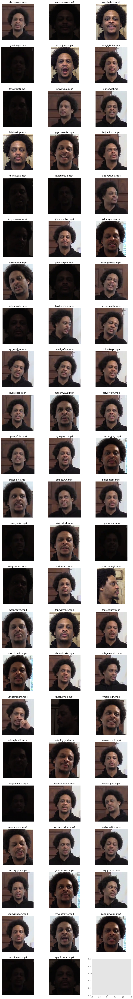

In [93]:
show_faces(df2[df2['class']==34])

In [21]:
def ff(father, v):
    if father[v]==v:
        return v
    father[v] = ff(father, father[v])
    return father[v]

def union_find(nodes, edges, father):

    for node in nodes:  # 初始化为本身
        father[node] = node
 
    for edge in edges:  # 标记父节点
        if ff(father, edge[0]) == ff(father, edge[1]):
            continue
        father[ff(father, edge[0])] = ff(father, edge[1])
 
    for node in nodes:
        father[node] = ff(father, node)
 
    L = {}
    for i, f in enumerate(father):
        L[f] = []
    for i, f in enumerate(father):
        L[f].append(i)
 
    return L

def union(df2, n_clusters):
    nodes = list(range(0, n_clusters))
    edges = []
    father = [0]*len(nodes)     # 记录父节点
    
    for fn in indexes2:
        tempdf = df2.xs(fn, level=0)
        if len(tempdf)>1:
            classes = list(set(tempdf['class']))
            for i in range(len(classes)-1):
                edges.append([classes[i],classes[i+1]])

    L = union_find(nodes, edges, father)
    
    union_anc = {}
    for fa,i in L.items():
        for class_id in i:
            union_anc[class_id]=fa
            
    print('num of classes:', len(L))
    df2['union_anc'] = df2['class'].apply(lambda x: union_anc[x])
    
    return df2, L

In [107]:
# 我靠还真TM有 A和B聊天，B和C聊天，C和D聊天
# show_faces(df2[df2['union_anc']==1410])

# train, test, validation split

In [33]:
def gen_split(df2, L):
    splits = {}
    for i in L.values():
        split = np.random.rand()
        if split < 0.75:
            split = 'train'
        elif split < 0.9:
            split = 'validation'
        else:
            split = 'test'
        for class_id in i:
            splits[class_id]=split
    df2['split'] = df2['class'].apply(lambda x: splits[x])
    return df2

In [11]:
def process_metadata(metadata, df2):

    def get_split(row):
        if row.label == 'REAL':
            if row.name not in indexes2:
                return -1
            return df2.at[(row.name,0),'split']
        else:
            try:
                return df2.at[(row.original,0),'split']
            except:
                return -1

    metadata['split_kailu'] = metadata.apply(get_split, axis=1)
    
    def get_person(row):
        name = row.name
        if row.label == 'FAKE':
            name = row.original
        if name not in indexes2:
                return -1
        return len(df2.xs(name, level=0))

    metadata['person_num'] = metadata.apply(get_person, axis=1)
    
    return metadata

In [23]:
def get_metadata(old_metadata, n_clusters, seed):
    np.random.seed(seed)
    random.seed(seed)
    
    df2 = get_df2(n_clusters=n_clusters)
    df2, L = union(df2, n_clusters)
    
    len_train, len_val, len_test = 0,0,0
    cnt = 0
    while not(16000-cnt*100 < len_train and 500-cnt*10 < len_val and 500-cnt*10 < len_test):
        df2 = gen_split(df2, L)
        len_train = len(df2[df2['split']=='train'])
        len_val = len(df2[df2['split']=='validation'])
        len_test = len(df2[df2['split']=='test'])
        cnt += 1
    print(len_train, len_val, len_test)
    
    metadata = process_metadata(old_metadata, df2)
    return metadata

In [42]:
seeds = (np.random.rand(2200, 10)*1e9).astype(int)
# for i in list(range(10, 200, 20))+list(range(200, 2000, 200)):
for i in list(range(800, 2000, 200)):
    for j in range(3):
        seed = seeds[i,j]
        train_sample_metadata = get_metadata(train_sample_metadata, i, seed)
        train_sample_metadata.T.to_json(f'/data/deepfake/metadata/metadata_{i}_{seed}.json')

inertia: 5425.541060940824
maxdis: 1.0565859
num of classes: 485
17968 1470 1401
inertia: 5430.791499685075
maxdis: 0.96866584
num of classes: 481
18003 1729 1107
inertia: 5435.8188696501375
maxdis: 0.98529
num of classes: 487
17984 1517 1338
inertia: 5132.045279334583
maxdis: 1.0302718
num of classes: 628
17604 1805 1430
inertia: 5126.315761369179
maxdis: 0.9105671
num of classes: 623
17691 1945 1203
inertia: 5128.5799693047775
maxdis: 0.85819304
num of classes: 639
18498 1298 1043
inertia: 4878.60780431366
maxdis: 0.96774244
num of classes: 782
17560 1704 1575
inertia: 4887.442356735585
maxdis: 0.94895667
num of classes: 780
16665 1825 2349
inertia: 4885.6051255436405
maxdis: 0.95754063
num of classes: 781
17080 2192 1567
inertia: 4677.370719800894
maxdis: 0.8932504
num of classes: 926
17591 1815 1433
inertia: 4678.507114991585
maxdis: 1.0218215
num of classes: 942
17716 1540 1583
inertia: 4679.804444069032
maxdis: 0.94895667
num of classes: 946
17429 1891 1519
inertia: 4508.40389710

In [41]:
import glob
len(glob.glob('/data/deepfake/metadata/metadata_*.json'))

39

In [39]:
!rm -rf /data/deepfake/metadata/*

# Other stuff

# 几个由于数据不均衡导致的问题和BUG

* 训练集中负例太多且多样，而正例的脸就那么一点，一个脸作为正例太多，可能被记住
* 同理测试集中，目前划分还是不均衡的，所以需要随机删除75%的负例，然而正例过少且不能删，所以不少正例脸会是一样的，导致测试结果不一定稳定
* LB中，暂不明确数据生成方式，只知道正负例均衡，但目前猜测到两个可以利用的BUG
* 如果LB中对于同一个人的10s视频出现了多个，且对应的负例生成采用每个10s单独生成。那么根据视频背景环境聚类，然后再取人脸特征的众数，就是真实脸的特征。
* 如果LB中对于同一个人的多个10s视频，全都fake到另外同一个人脸上，那么对于视频背景聚类后，应该根据人脸特征可以划分成两个大类，而其中fake的一类只要有一个视频出现明显合成错误（似乎在人物脸部倾斜角度稍大的情况下，fake出来效果糟糕），则可以推出全部都是假的。
* 一些额外内容，我们需要极为高效的人脸bounding box算法和人脸特征提取算法

In [72]:
train_sample_metadata[train_sample_metadata['label']=='REAL'].head()

,label,original,split,split_kailu
aayrffkzxn.mp4,REAL,None,train,train
apedduehoy.mp4,REAL,None,train,train
apvzjkvnwn.mp4,REAL,None,train,validation
chqqxfuuzi.mp4,REAL,None,train,train
ddtbarpcgo.mp4,REAL,None,train,train


In [74]:
train_sample_metadata[train_sample_metadata['original']=='apvzjkvnwn.mp4']

,label,original,split,split_kailu
augowetyej.mp4,FAKE,apvzjkvnwn.mp4,train,validation
axbvoepbdc.mp4,FAKE,apvzjkvnwn.mp4,train,validation
cxjtjcinqt.mp4,FAKE,apvzjkvnwn.mp4,train,validation
gczieafvpe.mp4,FAKE,apvzjkvnwn.mp4,train,validation
jeosukfzow.mp4,FAKE,apvzjkvnwn.mp4,train,validation
kanuhxwqaa.mp4,FAKE,apvzjkvnwn.mp4,train,validation
nbibouebku.mp4,FAKE,apvzjkvnwn.mp4,train,validation
qjsroipniu.mp4,FAKE,apvzjkvnwn.mp4,train,validation
qmmzklpowl.mp4,FAKE,apvzjkvnwn.mp4,train,validation
vrceadqnhq.mp4,FAKE,apvzjkvnwn.mp4,train,validation


In [28]:
train_sample_metadata[train_sample_metadata['person_num']>4]

,label,original,split,split_kailu,person_num
cacdswmrdp.mp4,REAL,None,train,train,5
gtawaprccv.mp4,FAKE,cacdswmrdp.mp4,train,train,5
mccibfjkqx.mp4,FAKE,cacdswmrdp.mp4,train,train,5
mlcdfxfbhd.mp4,FAKE,cacdswmrdp.mp4,train,train,5
negnavupsk.mp4,FAKE,cacdswmrdp.mp4,train,train,5
xilquenqtd.mp4,FAKE,cacdswmrdp.mp4,train,train,5


In [21]:
df2.head()

,,class,frame,face_feature,union_anc,split
aayrffkzxn.mp4,0,896,0,"([515.6837158203125, 457.1701965332031, 762.01...",896,test
apedduehoy.mp4,0,191,0,"([533.0321044921875, 36.80067825317383, 717.61...",191,validation
apvzjkvnwn.mp4,0,450,0,"([976.5567016601562, 278.0755310058594, 1213.2...",450,train
chqqxfuuzi.mp4,0,191,0,"([449.8432312011719, 313.4251403808594, 610.54...",191,validation
ddtbarpcgo.mp4,0,763,0,"([451.9956359863281, 877.928466796875, 557.519...",763,train


# 避开生成数据过程BUG的训练方式

* 方案1，抛开时序，建立时序无关模型，每次每个视频取一帧，drop掉多个人脸的fake数据，找到人脸bbox，向外扩30px，调整到256 * 256 然后每次随机crop 112 * 112的范围，作为一张图片给网络训练。
* 对于多个人fake，利用每次只fake一张脸进行识别。

# Estimate Var and Mean

In [43]:
def get_mean_var(dataframe):

    all_imgs = []
    for fn, frame_index, face_index in tqdm(dataframe.sample(n=10000).index):
        video_file = os.path.join(train_dir, fn)
        cap = cv.VideoCapture(video_file)
        
        cap.set(cv2.CAP_PROP_POS_FRAMES, frame_index)  #设置要获取的帧号
        _, frame=cap.read()
        if _ == False:
            print("Reading Failed at " + fn)
        cap.release()
        
        left, top, right, bottom = dataframe.at[(fn, frame_index, face_index), 'bbox'].astype(int)
        frame_face = frame[top:bottom, left:right]
                
        image = cv.cvtColor(frame_face, cv.COLOR_BGR2RGB)
        image = cv.resize(image, (224, 224))/255
        all_imgs.append(image)
    
    all_imgs = np.stack(all_imgs)
    print(f"mean: [{np.mean(all_imgs[:,:,:,0])},{np.mean(all_imgs[:,:,:,1])},{np.mean(all_imgs[:,:,:,2])}]")
    print(f"std: [{np.std(all_imgs[:,:,:,0])},{np.std(all_imgs[:,:,:,1])},{np.std(all_imgs[:,:,:,2])}]")
    
get_mean_var(dfbox[:])

100%|██████████| 10000/10000 [48:42<00:00,  3.47it/s] 


mean: [0.4294808522471488,0.3224705249287213,0.3000745109684491]
var: [0.05160604490603585,0.04140944845817726,0.039261207536230004]


In [26]:
metadata = pd.read_json("metadata_kailu.json").T

In [44]:
index_bb = dfbox.index.get_level_values(0)

# 一些额外发现

* 只有一个人脸的视频中，也能有闪烁，比如azrdwmzpqb.mp4

In [57]:
video_path = "/data1/data/deepfake/dfdc_train"
filename = "lvipqrzjgm.mp4"
frame = 280
cap = cv2.VideoCapture(os.path.join(video_path, filename))
print(cap.get(7))
cap.set(1, frame)  # 设置要获取的帧号
_, frame_img = cap.read()
if not _:
    print("Reading " + filename + " Failed")
cap.release()

300.0
Reading lvipqrzjgm.mp4 Failed


In [68]:
video_path = "/data1/data/deepfake/dfdc_train"
filename = "lvipqrzjgm.mp4"
frame = 280
cap = cv2.VideoCapture(os.path.join(video_path, filename))
frames = []
while(cap.isOpened()):
    ret, frame = cap.read()
    if ret==True:
        frames.append(frame)
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break
    else:
        break
cap.release()
print(len(frames))

259


In [23]:
from skvideo.io import vread
import time
import cv2
import os

video_path = "/data1/data/deepfake/dfdc_train/"
filename = "lvipqrzjgm.mp4"
start = time.time()

v = vread(video_path + filename)

# frame = 280
# cap = cv2.VideoCapture(os.path.join(video_path, filename))
# frames = []
# while(cap.isOpened()):
#     ret, frame = cap.read()
#     if ret==True:
#         frames.append(frame)
#         if cv2.waitKey(1) & 0xFF == ord('q'):
#             break
#     else:
#         break
# cap.release()

print(time.time()-start)

3.0596930980682373


In [71]:
train_sample_metadata[train_sample_metadata['person_num']==5]

,label,original,split,split_kailu,person_num
cacdswmrdp.mp4,REAL,None,train,train,5
gtawaprccv.mp4,FAKE,cacdswmrdp.mp4,train,train,5
mccibfjkqx.mp4,FAKE,cacdswmrdp.mp4,train,train,5
mlcdfxfbhd.mp4,FAKE,cacdswmrdp.mp4,train,train,5
negnavupsk.mp4,FAKE,cacdswmrdp.mp4,train,train,5
xilquenqtd.mp4,FAKE,cacdswmrdp.mp4,train,train,5


# Split by package

In [82]:
import glob
datas = glob.glob("/data1/data/deepfake/dfdc_train/metadata_*.json")

In [83]:
datas = [data for data in datas if len(data) == len('/data1/data/deepfake/dfdc_train/metadata_00.json')]

In [84]:
test = ['/data1/data/deepfake/dfdc_train/metadata_40.json',]

val = ['/data1/data/deepfake/dfdc_train/metadata_41.json',
      '/data1/data/deepfake/dfdc_train/metadata_42.json',
      '/data1/data/deepfake/dfdc_train/metadata_43.json',
      '/data1/data/deepfake/dfdc_train/metadata_44.json',
      '/data1/data/deepfake/dfdc_train/metadata_45.json',
      '/data1/data/deepfake/dfdc_train/metadata_46.json',
      '/data1/data/deepfake/dfdc_train/metadata_47.json',
      '/data1/data/deepfake/dfdc_train/metadata_48.json',
      '/data1/data/deepfake/dfdc_train/metadata_49.json',]

train = [data for data in datas if (data not in test) and (data not in val)]

In [86]:
def extract_indexes(files):
    ret = []
    for file in files:
        meta = pd.read_json(file).T
        ret += list(meta[meta['label'] == "REAL"].index)
    return ret

def set_split(indexes, label):
    def sets(row):
        if row.name in indexes:
            return label
        return row["split_kailu"]
    train_sample_metadata['split_kailu'] = train_sample_metadata.apply(sets, axis=1)

In [87]:
test_index = extract_indexes(test)

In [88]:
set_split(test_index, 'test')

In [89]:
set_split(extract_indexes(val), 'validation')

In [90]:
set_split(extract_indexes(train), 'train')

In [91]:
def get_split(row):
    if row.label == 'REAL':
        return train_sample_metadata.loc[row.name,'split_kailu']
    else:
        return train_sample_metadata.loc[row.original,'split_kailu']

train_sample_metadata['split_kailu'] = train_sample_metadata.apply(get_split, axis=1)

In [92]:
train_sample_metadata.T.to_json(f'/data/deepfake/metadata/metadata_40_49.json')

# split by human

In [83]:
def get_cluster2(n_clusters = 460):
    estimator = KMeans(n_clusters=n_clusters)#这个参数要二分一下
    estimator.fit(X)
    label_pred = estimator.labels_ 
    centers = estimator.cluster_centers_
    print("inertia:", estimator.inertia_)
    max_dis_from_center = 0
    for i in range(len(centers)):
        max_dis_from_center = max(max_dis_from_center, dist(centers[label_pred[i]], X[i]))
    print("maxdis:", max_dis_from_center) #0.6753322
    return label_pred, estimator.inertia_

label = []
iner = 1e9
for i in range(20):
    labelt, inert = get_cluster2()
    if inert < iner:
        iner = inert
        label = labelt

inertia: 6362.640938149069
maxdis: 1.0365338
inertia: 6354.261906837404
maxdis: 0.992391
inertia: 6336.085482886408
maxdis: 0.992391
inertia: 6346.1770364490485
maxdis: 1.0098335
inertia: 6325.9930670788
maxdis: 0.9961897
inertia: 6350.39406716263
maxdis: 1.0411682
inertia: 6356.345801228772
maxdis: 1.0078349
inertia: 6349.785691542863
maxdis: 1.0138211
inertia: 6328.3363624538115
maxdis: 1.0480908
inertia: 6335.034786661011
maxdis: 1.0181406
inertia: 6351.904734754832
maxdis: 1.0104696
inertia: 6344.382712677027
maxdis: 1.0113447
inertia: 6355.726532956127
maxdis: 0.9973348
inertia: 6318.581700071467
maxdis: 1.0042601
inertia: 6358.940076470572
maxdis: 0.9793643
inertia: 6331.856456165232
maxdis: 1.0083663
inertia: 6338.804350823528
maxdis: 0.95487154
inertia: 6353.470579424971
maxdis: 1.017178
inertia: 6333.501007894154
maxdis: 1.0480908


KeyboardInterrupt: 

In [243]:
df2 = pd.DataFrame({(f.file_name, f.face_index):[label[idx], f.frame_index, f.face_feature] for idx,f in enumerate(face_list)}, index = ['class','frame','face_feature']).T

In [244]:
df2.head()

,,class,frame,face_feature
aayrffkzxn.mp4,0,105,0,"([515.6837158203125, 457.170166015625, 762.011..."
apedduehoy.mp4,0,105,0,"([533.0321044921875, 36.80067443847656, 717.61..."
apvzjkvnwn.mp4,0,105,0,"([976.5567016601562, 278.0755310058594, 1213.2..."
chqqxfuuzi.mp4,0,105,0,"([449.8432312011719, 313.4251403808594, 610.54..."
ddtbarpcgo.mp4,0,105,0,"([451.9956359863281, 877.928466796875, 557.519..."


In [245]:
views = pd.concat([df2[df2['class']==i].sample(1) for i in range(460)])
views

,,class,frame,face_feature
wsakyfrbca.mp4,0,0,0,"([844.1597900390625, 162.56422424316406, 992.1..."
uwnogtuazk.mp4,0,1,0,"([904.8841552734375, 71.87779998779297, 1067.5..."
theyuezzhi.mp4,0,2,0,"([253.16140747070312, 326.3157958984375, 428.7..."
sghdekqnnn.mp4,0,3,0,"([876.718994140625, 136.16851806640625, 1114.2..."
lxoyzgfgxg.mp4,0,4,0,"([953.8943481445312, 163.04684448242188, 1073...."
pnashuxnit.mp4,1,5,0,"([212.55975341796875, 300.3139953613281, 298.2..."
cfmzfzamfj.mp4,0,6,0,"([848.6284790039062, 99.30300903320312, 991.59..."
bevjclbhuo.mp4,0,7,0,"([934.4526977539062, 130.28564453125, 1056.598..."
wrgflmpxpi.mp4,0,8,0,"([843.7666015625, 85.56488800048828, 961.06311..."
xrtmepdfyh.mp4,0,9,0,"([436.5745544433594, 151.96600341796875, 550.9..."







  0%|          | 0/460 [00:00<?, ?it/s]




  0%|          | 1/460 [00:00<06:20,  1.21it/s]




  0%|          | 2/460 [00:01<06:13,  1.23it/s]




  1%|          | 3/460 [00:03<07:39,  1.00s/it]




  1%|          | 4/460 [00:04<09:40,  1.27s/it]




  1%|          | 5/460 [00:08<14:52,  1.96s/it]




  1%|▏         | 6/460 [00:10<15:43,  2.08s/it]




  2%|▏         | 7/460 [00:14<18:15,  2.42s/it]




  2%|▏         | 8/460 [00:16<17:58,  2.39s/it]




  2%|▏         | 9/460 [00:17<14:56,  1.99s/it]




  2%|▏         | 10/460 [00:18<12:34,  1.68s/it]




  2%|▏         | 11/460 [00:19<11:12,  1.50s/it]




  3%|▎         | 12/460 [00:20<10:03,  1.35s/it]




  3%|▎         | 13/460 [00:21<08:31,  1.14s/it]




  3%|▎         | 14/460 [00:22<08:22,  1.13s/it]




  3%|▎         | 15/460 [00:23<07:52,  1.06s/it]




  3%|▎         | 16/460 [00:26<11:58,  1.62s/it]




  4%|▎         | 17/460 [00:30<17:13,  2.33s/it]




  4%|▍         | 18/460 [00:33<18:30,  2.51s/it]




  4%|▍

 26%|██▌       | 120/460 [03:07<06:02,  1.06s/it]




 26%|██▋       | 121/460 [03:11<10:05,  1.79s/it]




 27%|██▋       | 122/460 [03:14<12:17,  2.18s/it]




 27%|██▋       | 123/460 [03:17<13:34,  2.42s/it]




 27%|██▋       | 124/460 [03:18<11:36,  2.07s/it]




 27%|██▋       | 125/460 [03:19<09:36,  1.72s/it]




 27%|██▋       | 126/460 [03:20<07:50,  1.41s/it]




 28%|██▊       | 127/460 [03:21<07:25,  1.34s/it]




 28%|██▊       | 128/460 [03:22<06:50,  1.24s/it]




 28%|██▊       | 129/460 [03:23<06:39,  1.21s/it]




 28%|██▊       | 130/460 [03:24<06:23,  1.16s/it]




 28%|██▊       | 131/460 [03:25<05:48,  1.06s/it]




 29%|██▊       | 132/460 [03:25<05:15,  1.04it/s]




 29%|██▉       | 133/460 [03:26<05:11,  1.05it/s]




 29%|██▉       | 134/460 [03:30<08:52,  1.63s/it]




 29%|██▉       | 135/460 [03:34<14:02,  2.59s/it]




 30%|██▉       | 136/460 [03:37<13:49,  2.56s/it]




 30%|██▉       | 137/460 [03:38<11:32,  2.14s/it]




 30%|███       | 138/460 [03

 52%|█████▏    | 238/460 [06:21<04:21,  1.18s/it]




 52%|█████▏    | 239/460 [06:22<03:48,  1.03s/it]




 52%|█████▏    | 240/460 [06:23<03:39,  1.00it/s]




 52%|█████▏    | 241/460 [06:24<03:34,  1.02it/s]




 53%|█████▎    | 242/460 [06:24<03:07,  1.16it/s]




 53%|█████▎    | 243/460 [06:26<03:33,  1.02it/s]




 53%|█████▎    | 244/460 [06:26<03:29,  1.03it/s]




 53%|█████▎    | 245/460 [06:29<05:01,  1.40s/it]




 53%|█████▎    | 246/460 [06:33<07:49,  2.19s/it]




 54%|█████▎    | 247/460 [06:36<08:38,  2.44s/it]




 54%|█████▍    | 248/460 [06:38<08:06,  2.29s/it]




 54%|█████▍    | 249/460 [06:39<07:21,  2.09s/it]




 54%|█████▍    | 250/460 [06:41<06:44,  1.93s/it]




 55%|█████▍    | 251/460 [06:42<05:33,  1.59s/it]




 55%|█████▍    | 252/460 [06:43<04:35,  1.32s/it]




 55%|█████▌    | 253/460 [06:43<04:02,  1.17s/it]




 55%|█████▌    | 254/460 [06:44<03:49,  1.11s/it]




 55%|█████▌    | 255/460 [06:45<03:31,  1.03s/it]




 56%|█████▌    | 256/460 [06

 77%|███████▋  | 356/460 [08:43<01:39,  1.04it/s]




 78%|███████▊  | 357/460 [08:44<01:33,  1.10it/s]




 78%|███████▊  | 358/460 [08:45<01:30,  1.13it/s]




 78%|███████▊  | 359/460 [08:46<01:30,  1.12it/s]




 78%|███████▊  | 360/460 [08:47<01:35,  1.05it/s]




 78%|███████▊  | 361/460 [08:48<01:27,  1.13it/s]




 79%|███████▊  | 362/460 [08:49<01:23,  1.17it/s]




 79%|███████▉  | 363/460 [08:49<01:20,  1.20it/s]




 79%|███████▉  | 364/460 [08:51<01:43,  1.08s/it]




 79%|███████▉  | 365/460 [08:52<01:50,  1.16s/it]




 80%|███████▉  | 366/460 [08:53<01:41,  1.08s/it]




 80%|███████▉  | 367/460 [08:55<01:47,  1.16s/it]




 80%|████████  | 368/460 [08:56<02:00,  1.31s/it]




 80%|████████  | 369/460 [08:57<01:50,  1.21s/it]




 80%|████████  | 370/460 [08:58<01:37,  1.08s/it]




 81%|████████  | 371/460 [08:59<01:31,  1.03s/it]




 81%|████████  | 372/460 [09:00<01:20,  1.09it/s]




 81%|████████  | 373/460 [09:03<02:17,  1.58s/it]




 81%|████████▏ | 374/460 [09

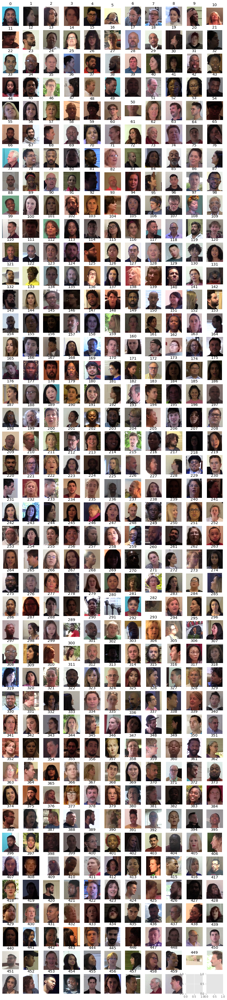

In [246]:
show_faces(views)






  0%|          | 0/36 [00:00<?, ?it/s]




  3%|▎         | 1/36 [00:00<00:11,  3.06it/s]




  6%|▌         | 2/36 [00:00<00:10,  3.36it/s]




  8%|▊         | 3/36 [00:01<00:19,  1.72it/s]




 11%|█         | 4/36 [00:03<00:27,  1.15it/s]




 14%|█▍        | 5/36 [00:05<00:41,  1.32s/it]




 17%|█▋        | 6/36 [00:07<00:42,  1.42s/it]




 19%|█▉        | 7/36 [00:13<01:24,  2.92s/it]




 22%|██▏       | 8/36 [00:15<01:14,  2.67s/it]




 25%|██▌       | 9/36 [00:17<01:07,  2.49s/it]




 28%|██▊       | 10/36 [00:20<01:01,  2.37s/it]




 31%|███       | 11/36 [00:21<00:52,  2.10s/it]




 33%|███▎      | 12/36 [00:24<00:58,  2.43s/it]




 36%|███▌      | 13/36 [00:29<01:13,  3.21s/it]




 39%|███▉      | 14/36 [00:31<01:03,  2.90s/it]




 42%|████▏     | 15/36 [00:36<01:13,  3.48s/it]




 44%|████▍     | 16/36 [00:38<00:58,  2.91s/it]




 47%|████▋     | 17/36 [00:39<00:47,  2.49s/it]




 50%|█████     | 18/36 [00:43<00:49,  2.73s/it]




 53%|█████▎    | 19/36 [0

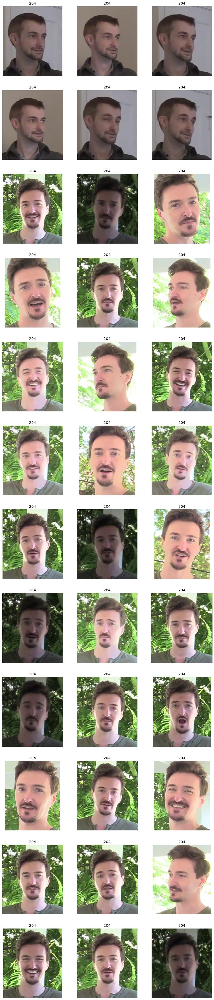

In [182]:
show_faces(df2[df2['class']==204]) #358 76 336

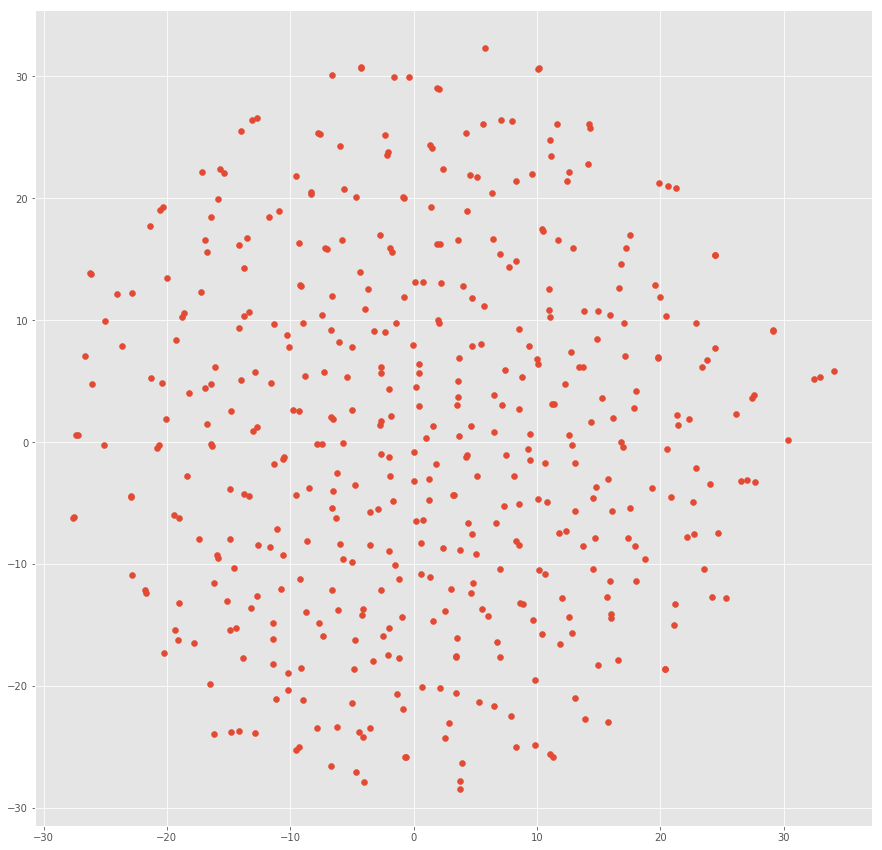

In [133]:
X1 = np.array([face.face_feature.normed_embedding for face in views.itertuples()])

Y = TSNE(init='pca').fit_transform(X1)

fig, axes = plt.subplots(1, 1, figsize=(15, 15))
axes = np.array(axes)
axes = axes.reshape(-1)
plt.scatter(Y[:, 0], Y[:, 1], cmap=plt.cm.Spectral)

plt.show()

In [11]:
train_sample_metadata = pd.read_json("/data/deepfake/metadata/metadata_seq.json").T

In [183]:
validates = [204, 358, 76, 336, 450, 30] #, 177, 210] # 255? 262?
tests = [148, 333]

set_split(train_sample_metadata.index, "-1")

set_split(df2.index.get_level_values(0) , "train")

vals = pd.concat([df2[df2['class']==i] for i in validates])
set_split(vals.index.get_level_values(0) , "validation")

tes = pd.concat([df2[df2['class']==i] for i in tests])
set_split(tes.index.get_level_values(0) , "test")

train_sample_metadata['split_kailu'] = train_sample_metadata.apply(get_split, axis=1)

In [184]:
train_sample_metadata[(train_sample_metadata['label'] == "REAL") & (train_sample_metadata['split_kailu'] == "validation")]

,label,original,person_num,split,split_kailu
ebxruufffq.mp4,REAL,None,2,train,validation
eomsfwykap.mp4,REAL,None,2,train,validation
hldycaemxz.mp4,REAL,None,2,train,validation
hpeyakpjiu.mp4,REAL,None,2,train,validation
keikgjgled.mp4,REAL,None,2,train,validation
rhvponjpjq.mp4,REAL,None,2,train,validation
aazqkwibxi.mp4,REAL,None,1,train,validation
bijmjhpvgg.mp4,REAL,None,1,train,validation
bpsjlpirye.mp4,REAL,None,1,train,validation
bpujsteojc.mp4,REAL,None,1,train,validation


In [185]:
train_sample_metadata.T.to_json(f'/data/deepfake/metadata/metadata_human.json')

# Advanced Split

In [13]:
def dist(emb1, emb2):
    return np.sum(np.square(emb1 - emb2))

def get_face_sub2(index, process_id, face_detector):
    print("process id: ", process_id, "index :" , index)
    A = face_detector

    id2faces = dict()
    for fn in tqdm(index):
        label = train_sample_metadata.loc[fn]['label']
        orig = train_sample_metadata.loc[fn]['label']
        
        cache_path = os.path.join(face_cache, fn.split('.')[0])
        if os.path.exists(cache_path):
            files = os.listdir(cache_path)
            if len(files) > 0:
                with open(os.path.join(cache_path, files[0]), 'rb') as f:
                    face = Image.open(f)
                    face.load()
                    frame = np.array(face)
            else:
                print(f"{cache_path} is empty")
                continue
        else:
            print(f"{cache_path} not exists")
            continue
        
        h, w = frame.shape[:2]
        face_list = A.get(frame)
        if len(face_list) == 0:
#             print(f'Could not find face in {fn}')
            continue
        
        id2faces[fn] = face_list[0].normed_embedding
    
#     print(id2faces)
    return id2faces

def get_face_list2(index, gpu_id = -1):
    A = insightface.app.FaceAnalysis()
    A.prepare(gpu_id)
    return get_face_sub2(index, 0, A)

get_face_list2(indexes[:10], gpu_id = 0);

KeyboardInterrupt: 

In [14]:
temp = get_face_list2(indexes, gpu_id = 0)

[32, 16, 8] {'32': {'SCALES': (32, 16), 'BASE_SIZE': 16, 'RATIOS': (1.0,), 'ALLOWED_BORDER': 9999}, '16': {'SCALES': (8, 4), 'BASE_SIZE': 16, 'RATIOS': (1.0,), 'ALLOWED_BORDER': 9999}, '8': {'SCALES': (2, 1), 'BASE_SIZE': 16, 'RATIOS': (1.0,), 'ALLOWED_BORDER': 9999}}
use_landmarks True


  0%|          | 0/19154 [00:00<?, ?it/s]

process id:  0 index : Index(['aayrffkzxn.mp4', 'apedduehoy.mp4', 'apvzjkvnwn.mp4', 'chqqxfuuzi.mp4',
       'ddtbarpcgo.mp4', 'dhjnjkzuhq.mp4', 'didzujjhtg.mp4', 'doniqevxeg.mp4',
       'dpevefkefv.mp4', 'dxfdovivlw.mp4',
       ...
       'znckxsojok.mp4', 'zpgqjxivpx.mp4', 'zpxirfbfiw.mp4', 'zpzycmsaik.mp4',
       'zsvfzkpjur.mp4', 'zuduvanawx.mp4', 'zwqdszjdop.mp4', 'zxafputanf.mp4',
       'zyeaapjwyg.mp4', 'zylribcaeu.mp4'],
      dtype='object', length=19154)


  0%|          | 79/19154 [00:03<09:12, 34.50it/s]  

Could not find face in xchzardbfa.mp4


  1%|          | 129/19154 [00:04<06:54, 45.92it/s]

Could not find face in hhhvnhhqsc.mp4


  1%|          | 154/19154 [00:05<07:01, 45.08it/s]

Could not find face in nymodlmxni.mp4


  1%|          | 180/19154 [00:06<06:45, 46.77it/s]

Could not find face in vizerpsvbz.mp4


  1%|          | 206/19154 [00:06<06:57, 45.34it/s]

Could not find face in akrubjfzzc.mp4


  2%|▏         | 354/19154 [00:10<07:18, 42.90it/s]

Could not find face in rfukeoxpqu.mp4


  3%|▎         | 609/19154 [00:16<06:56, 44.51it/s]

Could not find face in vjenypjkzt.mp4


  3%|▎         | 669/19154 [00:17<07:17, 42.25it/s]

Could not find face in bsjezfsydc.mp4


  4%|▎         | 685/19154 [00:17<06:54, 44.57it/s]

Could not find face in dxwvavgnsr.mp4
Could not find face in fszexmwczt.mp4


  4%|▎         | 705/19154 [00:18<06:36, 46.50it/s]

Could not find face in heoufzaddn.mp4
Could not find face in hmugoovuhr.mp4


  5%|▍         | 870/19154 [00:22<07:19, 41.57it/s]

Could not find face in cefzoeryat.mp4


  5%|▍         | 910/19154 [00:23<06:51, 44.34it/s]

Could not find face in fimhhyetym.mp4


  5%|▌         | 1045/19154 [00:26<06:39, 45.30it/s]

Could not find face in owkrfyfxpw.mp4
Could not find face in pjibpowymk.mp4


  6%|▌         | 1055/19154 [00:26<06:55, 43.54it/s]

Could not find face in ptchnzeeqc.mp4


  6%|▌         | 1090/19154 [00:27<06:59, 43.02it/s]

Could not find face in sitvymbvfh.mp4


  6%|▌         | 1141/19154 [00:28<06:39, 45.07it/s]

Could not find face in wbvjhwxgfk.mp4
Could not find face in wjxmmjmchv.mp4


  6%|▌         | 1167/19154 [00:28<06:24, 46.83it/s]

Could not find face in xhsramepav.mp4
Could not find face in xzcexrifxq.mp4


  6%|▌         | 1177/19154 [00:29<06:55, 43.31it/s]

Could not find face in ykgdmawthl.mp4


  6%|▋         | 1207/19154 [00:29<06:40, 44.77it/s]

Could not find face in awjizuuwtg.mp4


  6%|▋         | 1217/19154 [00:30<06:38, 45.00it/s]

Could not find face in bhgjhzlage.mp4
Could not find face in brqcongpqi.mp4


  7%|▋         | 1333/19154 [00:32<06:27, 46.00it/s]

Could not find face in iarobzzslu.mp4


  8%|▊         | 1443/19154 [00:35<06:26, 45.77it/s]

Could not find face in papoalwbmv.mp4


  8%|▊         | 1514/19154 [00:36<06:32, 44.91it/s]

Could not find face in terivbcgpp.mp4


  8%|▊         | 1573/19154 [00:38<07:01, 41.71it/s]

Could not find face in wwfehhmmhl.mp4


  8%|▊         | 1583/19154 [00:38<06:43, 43.57it/s]

Could not find face in xugbywbvgv.mp4


 10%|█         | 1958/19154 [00:47<07:06, 40.34it/s]

Could not find face in ahngpfavrr.mp4


 11%|█         | 2032/19154 [00:48<06:14, 45.76it/s]

Could not find face in hlcqjuwpsd.mp4


 11%|█         | 2068/19154 [00:49<06:07, 46.46it/s]

Could not find face in kberujkjfo.mp4


 11%|█         | 2119/19154 [00:50<06:16, 45.26it/s]

Could not find face in oqrdigzjls.mp4


 11%|█▏        | 2189/19154 [00:52<06:17, 44.90it/s]

Could not find face in viporlwbod.mp4


 12%|█▏        | 2254/19154 [00:53<06:14, 45.18it/s]

Could not find face in bxvloxsftn.mp4


 12%|█▏        | 2299/19154 [00:54<06:13, 45.08it/s]

Could not find face in hftypnppjr.mp4


 13%|█▎        | 2400/19154 [00:57<06:08, 45.48it/s]

Could not find face in pntqucycxy.mp4


 13%|█▎        | 2425/19154 [00:57<06:16, 44.47it/s]

Could not find face in rvxsaajmot.mp4


 13%|█▎        | 2460/19154 [00:58<06:13, 44.65it/s]

Could not find face in uvxicudfgh.mp4


 13%|█▎        | 2471/19154 [00:58<06:01, 46.16it/s]

Could not find face in wekjizzdnr.mp4


 13%|█▎        | 2486/19154 [00:59<06:02, 46.03it/s]

Could not find face in xnydzmkkrj.mp4


 13%|█▎        | 2501/19154 [00:59<06:12, 44.71it/s]

Could not find face in yurtzoovou.mp4


 13%|█▎        | 2526/19154 [00:59<06:18, 43.92it/s]

Could not find face in arqszxotbq.mp4


 14%|█▎        | 2597/19154 [01:01<06:03, 45.53it/s]

Could not find face in gggxkzqtvh.mp4


 14%|█▍        | 2682/19154 [01:03<06:07, 44.82it/s]

Could not find face in mrtxyivfzi.mp4


 15%|█▍        | 2828/19154 [01:06<06:00, 45.27it/s]

Could not find face in uzrkbzwdvi.mp4


 15%|█▍        | 2868/19154 [01:07<05:55, 45.86it/s]

Could not find face in ybsbipoacu.mp4


 15%|█▌        | 2923/19154 [01:08<06:26, 41.99it/s]

Could not find face in brfjxrbezo.mp4


 15%|█▌        | 2953/19154 [01:09<06:03, 44.63it/s]

Could not find face in dsnvzccwcm.mp4


 16%|█▌        | 2973/19154 [01:10<06:08, 43.87it/s]

Could not find face in gcwuhlegud.mp4


 16%|█▌        | 3073/19154 [01:12<06:30, 41.20it/s]

Could not find face in nnjpfzusji.mp4


 18%|█▊        | 3388/19154 [01:19<06:11, 42.40it/s]

Could not find face in lhxshnawpw.mp4


 18%|█▊        | 3428/19154 [01:20<06:05, 43.08it/s]

Could not find face in pgyrbuytsb.mp4


 18%|█▊        | 3448/19154 [01:21<05:56, 44.12it/s]

Could not find face in qvdkibrxei.mp4


 18%|█▊        | 3534/19154 [01:22<05:43, 45.46it/s]

Could not find face in wqnlooubux.mp4


 19%|█▊        | 3584/19154 [01:24<05:54, 43.87it/s]

Could not find face in amljqllcwj.mp4


 19%|█▉        | 3674/19154 [01:26<06:13, 41.47it/s]

Could not find face in finxnswaul.mp4


 19%|█▉        | 3699/19154 [01:26<05:56, 43.40it/s]

Could not find face in gxnmiqvuky.mp4


 20%|█▉        | 3779/19154 [01:28<05:35, 45.80it/s]

Could not find face in lqcotpccag.mp4


 20%|██        | 3895/19154 [01:31<05:35, 45.47it/s]

Could not find face in swqsphgsqj.mp4


 26%|██▌       | 4915/19154 [01:54<05:31, 42.98it/s]

Could not find face in kpkbtvsxlz.mp4


 26%|██▌       | 4925/19154 [01:54<05:17, 44.79it/s]

Could not find face in llutlpwmtz.mp4


 26%|██▌       | 4956/19154 [01:55<04:57, 47.73it/s]

Could not find face in nhuntfthtx.mp4
Could not find face in npjemrwacb.mp4


 27%|██▋       | 5086/19154 [01:58<05:30, 42.61it/s]

Could not find face in xjzbutlpup.mp4


 27%|██▋       | 5189/19154 [02:00<05:16, 44.08it/s]

Could not find face in fksbgzstce.mp4


 27%|██▋       | 5255/19154 [02:02<05:03, 45.74it/s]

Could not find face in jlzxvuxojs.mp4


 31%|███       | 5966/19154 [02:18<04:45, 46.17it/s]

Could not find face in adthviqaig.mp4
Could not find face in aeftglfxkv.mp4


 32%|███▏      | 6047/19154 [02:20<04:41, 46.64it/s]

Could not find face in fchpilzgfl.mp4


 32%|███▏      | 6162/19154 [02:22<04:55, 43.91it/s]

Could not find face in mcvxrfgkgc.mp4


 33%|███▎      | 6237/19154 [02:24<04:53, 44.01it/s]

Could not find face in qprdefhnbv.mp4


 33%|███▎      | 6292/19154 [02:25<04:40, 45.87it/s]

Could not find face in tteirtovcw.mp4


 33%|███▎      | 6367/19154 [02:27<05:12, 40.96it/s]

Could not find face in yybyvwtodb.mp4


 33%|███▎      | 6392/19154 [02:28<05:12, 40.90it/s]

Could not find face in awsznciprw.mp4


 34%|███▎      | 6452/19154 [02:29<04:38, 45.57it/s]

Could not find face in fiquxglbtj.mp4


 34%|███▍      | 6538/19154 [02:31<04:46, 44.08it/s]

Could not find face in jxrnlcoeba.mp4


 35%|███▌      | 6719/19154 [02:35<04:31, 45.74it/s]

Could not find face in vhvtjsiirh.mp4


 35%|███▌      | 6755/19154 [02:36<04:25, 46.76it/s]

Could not find face in xvykxozqpq.mp4


 36%|███▌      | 6816/19154 [02:37<04:37, 44.39it/s]

Could not find face in bzfhkpsthh.mp4


 36%|███▌      | 6846/19154 [02:38<04:46, 42.89it/s]

Could not find face in esarxzzvkx.mp4


 36%|███▌      | 6917/19154 [02:39<04:28, 45.60it/s]

/data/deepfake/faces/jwerbdhrmu is empty


 36%|███▌      | 6933/19154 [02:40<04:23, 46.36it/s]

Could not find face in liccnhjjvr.mp4
Could not find face in mholkuftuf.mp4


 36%|███▋      | 6949/19154 [02:40<04:17, 47.33it/s]

/data/deepfake/faces/ndvssqditd is empty


 36%|███▋      | 6991/19154 [02:41<04:17, 47.31it/s]

Could not find face in pxblqvswbc.mp4
Could not find face in qinmcwphzx.mp4


 37%|███▋      | 7001/19154 [02:41<04:17, 47.25it/s]

Could not find face in qpmtqbnguc.mp4


 37%|███▋      | 7042/19154 [02:42<04:16, 47.14it/s]

Could not find face in tcyzswrqqu.mp4


 38%|███▊      | 7183/19154 [02:45<04:30, 44.30it/s]

Could not find face in cxygklpkbx.mp4


 38%|███▊      | 7208/19154 [02:46<04:20, 45.89it/s]

Could not find face in ebxyllfnrk.mp4


 38%|███▊      | 7258/19154 [02:47<04:17, 46.17it/s]

Could not find face in gxvhxyghku.mp4


 38%|███▊      | 7284/19154 [02:48<04:28, 44.17it/s]

Could not find face in iiaoukzipu.mp4


 39%|███▉      | 7550/19154 [02:54<04:18, 44.88it/s]

Could not find face in vgkffuboll.mp4


 39%|███▉      | 7565/19154 [02:54<04:11, 46.06it/s]

Could not find face in wedoghnkxh.mp4


 40%|████      | 7695/19154 [02:57<04:11, 45.54it/s]

Could not find face in fdtmtbbbab.mp4


 42%|████▏     | 7961/19154 [03:03<04:03, 45.89it/s]

Could not find face in vnpgdojdpl.mp4


 42%|████▏     | 8032/19154 [03:05<03:59, 46.35it/s]

Could not find face in zejalimkaj.mp4
Could not find face in znwqwrogrj.mp4


 42%|████▏     | 8057/19154 [03:05<04:04, 45.37it/s]

Could not find face in avdfyvawxu.mp4


 42%|████▏     | 8112/19154 [03:06<04:16, 43.00it/s]

Could not find face in eitdwgzbtn.mp4


 43%|████▎     | 8157/19154 [03:07<04:07, 44.38it/s]

Could not find face in gsxhrxrxyp.mp4


 43%|████▎     | 8282/19154 [03:10<03:56, 45.92it/s]

Could not find face in orkbzcydjv.mp4


 44%|████▍     | 8382/19154 [03:13<04:14, 42.29it/s]

Could not find face in uqsictgsxf.mp4


 46%|████▌     | 8782/19154 [03:22<03:53, 44.38it/s]

Could not find face in tanzxmtcpo.mp4


 47%|████▋     | 8919/19154 [03:25<03:35, 47.45it/s]

Could not find face in cbfdwmtuoy.mp4
Could not find face in cgsytxotwz.mp4
Could not find face in citkfepusj.mp4


 47%|████▋     | 8934/19154 [03:25<03:43, 45.81it/s]

Could not find face in cwchwtkjze.mp4


 47%|████▋     | 8945/19154 [03:25<03:42, 45.79it/s]

Could not find face in drsvtbkrdr.mp4


 47%|████▋     | 8976/19154 [03:26<03:34, 47.41it/s]

Could not find face in fipanlabdz.mp4
Could not find face in fpiltwqkcz.mp4
Could not find face in fwjsjpgeua.mp4


 47%|████▋     | 9027/19154 [03:27<03:49, 44.15it/s]

Could not find face in ikuyatfgpk.mp4


 47%|████▋     | 9052/19154 [03:28<03:51, 43.68it/s]

Could not find face in kiqlwwdfox.mp4


 47%|████▋     | 9068/19154 [03:28<03:36, 46.48it/s]

Could not find face in lcvkqsoczm.mp4
Could not find face in lldvmpawap.mp4


 47%|████▋     | 9078/19154 [03:28<03:35, 46.81it/s]

Could not find face in mboekkzymy.mp4


 47%|████▋     | 9093/19154 [03:29<03:42, 45.15it/s]

Could not find face in mphdnxdxvb.mp4


 48%|████▊     | 9113/19154 [03:29<03:43, 44.94it/s]

Could not find face in nrfmehosle.mp4
Could not find face in nvmnvsqjsq.mp4


 48%|████▊     | 9149/19154 [03:30<03:42, 44.98it/s]

Could not find face in qfgpwxvhay.mp4


 48%|████▊     | 9184/19154 [03:31<03:49, 43.51it/s]

Could not find face in sorwnrzsuo.mp4


 48%|████▊     | 9215/19154 [03:31<03:36, 45.82it/s]

Could not find face in uuiaghtmqa.mp4
Could not find face in uusihxiomf.mp4


 48%|████▊     | 9230/19154 [03:32<03:38, 45.47it/s]

Could not find face in wfdlblolif.mp4


 48%|████▊     | 9240/19154 [03:32<03:31, 46.77it/s]

Could not find face in wqosikqmmo.mp4


 48%|████▊     | 9255/19154 [03:32<03:30, 46.95it/s]

Could not find face in xoeiyltigh.mp4
Could not find face in xspyysfmdj.mp4
Could not find face in xugrceeldg.mp4


 49%|████▊     | 9295/19154 [03:33<03:45, 43.79it/s]

Could not find face in zptkukgsrr.mp4


 49%|████▉     | 9365/19154 [03:35<03:34, 45.59it/s]

Could not find face in dshhxylazk.mp4


 49%|████▉     | 9386/19154 [03:35<03:27, 47.04it/s]

Could not find face in eviqugvhte.mp4
Could not find face in faaqmjvali.mp4


 49%|████▉     | 9446/19154 [03:37<03:31, 46.00it/s]

Could not find face in iqokmoltrr.mp4


 50%|████▉     | 9491/19154 [03:38<03:38, 44.27it/s]

Could not find face in ljeezbryke.mp4


 50%|████▉     | 9566/19154 [03:39<03:46, 42.35it/s]

Could not find face in qjftklhdbe.mp4


 51%|█████     | 9722/19154 [03:43<03:37, 43.34it/s]

/data/deepfake/faces/atvmxvwyns is empty
Could not find face in bejhvclboh.mp4


 51%|█████     | 9813/19154 [03:45<03:21, 46.39it/s]

/data/deepfake/faces/fysyrqfguw is empty
/data/deepfake/faces/gbqrgajyca is empty


 51%|█████▏    | 9858/19154 [03:46<03:24, 45.41it/s]

Could not find face in jislcvfnzf.mp4


 52%|█████▏    | 9899/19154 [03:47<03:16, 47.05it/s]

/data/deepfake/faces/mfnowqfdwl is empty


 52%|█████▏    | 9942/19154 [03:48<03:07, 49.05it/s]

Could not find face in pzrwraqsyv.mp4
/data/deepfake/faces/qeumxirsme is empty
Could not find face in qgztrlaprq.mp4


 52%|█████▏    | 9957/19154 [03:48<03:17, 46.49it/s]

Could not find face in rbhorxkdoe.mp4


 52%|█████▏    | 9982/19154 [03:49<03:23, 45.17it/s]

Could not find face in smggzgxymo.mp4


 52%|█████▏    | 9992/19154 [03:49<03:18, 46.14it/s]

Could not find face in tcgtwgfwuu.mp4


 52%|█████▏    | 10018/19154 [03:49<03:21, 45.30it/s]

Could not find face in utbukhjacn.mp4


 53%|█████▎    | 10059/19154 [03:50<03:19, 45.50it/s]

Could not find face in xobhsemxmv.mp4


 53%|█████▎    | 10090/19154 [03:51<03:22, 44.71it/s]

/data/deepfake/faces/zhfyuhonra is empty


 53%|█████▎    | 10110/19154 [03:52<03:22, 44.69it/s]

Could not find face in ajusgabgcr.mp4


 53%|█████▎    | 10145/19154 [03:52<03:24, 43.98it/s]

Could not find face in cqdytnllfm.mp4


 53%|█████▎    | 10160/19154 [03:53<03:16, 45.82it/s]

Could not find face in decpocsuhd.mp4


 53%|█████▎    | 10175/19154 [03:53<03:13, 46.40it/s]

Could not find face in dsubvafgyh.mp4


 54%|█████▎    | 10266/19154 [03:55<03:15, 45.42it/s]

Could not find face in jdoekxclgz.mp4
Could not find face in jsxfcybqpn.mp4


 54%|█████▍    | 10362/19154 [03:57<03:06, 47.23it/s]

Could not find face in oyhiaxpwfa.mp4


 54%|█████▍    | 10398/19154 [03:58<03:20, 43.64it/s]

Could not find face in raodkuhsdj.mp4


 55%|█████▍    | 10469/19154 [04:00<03:16, 44.27it/s]

Could not find face in vnxupuryad.mp4


 55%|█████▍    | 10489/19154 [04:00<03:09, 45.61it/s]

Could not find face in wqgiqcujfj.mp4


 58%|█████▊    | 11140/19154 [04:15<02:54, 45.89it/s]

/data/deepfake/faces/frtcdhlsmj is empty


 58%|█████▊    | 11170/19154 [04:16<02:55, 45.49it/s]

Could not find face in hnnjmlnatx.mp4


 60%|█████▉    | 11416/19154 [04:21<02:45, 46.72it/s]

/data/deepfake/faces/xcvmwbzgfo is empty
Could not find face in xhsnujtnec.mp4


 60%|█████▉    | 11452/19154 [04:22<02:53, 44.49it/s]

/data/deepfake/faces/zhvpotrxsq is empty


 60%|█████▉    | 11469/19154 [04:22<02:38, 48.50it/s]

/data/deepfake/faces/ahrqzxkppw is empty
/data/deepfake/faces/amvnlxbjdl is empty
/data/deepfake/faces/amzisjppsy is empty


 60%|██████    | 11496/19154 [04:23<02:40, 47.58it/s]

/data/deepfake/faces/bxtxxxylhv is empty


 60%|██████    | 11563/19154 [04:24<02:40, 47.16it/s]

/data/deepfake/faces/ezvpacuegj is empty
/data/deepfake/faces/ffhlqnapse is empty


 60%|██████    | 11574/19154 [04:25<02:38, 47.80it/s]

/data/deepfake/faces/fvfzksrsbd is empty


 61%|██████    | 11590/19154 [04:25<02:40, 47.04it/s]

/data/deepfake/faces/gjfkjtpnks is empty


 61%|██████    | 11601/19154 [04:25<02:41, 46.63it/s]

/data/deepfake/faces/guduwhfqep is empty


 61%|██████    | 11622/19154 [04:26<02:42, 46.42it/s]

Could not find face in iagyfexdei.mp4


 61%|██████    | 11653/19154 [04:26<02:35, 48.19it/s]

/data/deepfake/faces/jswhgnskzt is empty
Could not find face in juvfdsrodw.mp4


 61%|██████    | 11669/19154 [04:27<02:45, 45.33it/s]

/data/deepfake/faces/kolwvxizei is empty


 61%|██████    | 11685/19154 [04:27<02:40, 46.60it/s]

Could not find face in lwtsuekjgr.mp4


 61%|██████    | 11700/19154 [04:27<02:48, 44.35it/s]

Could not find face in mmyntjgyke.mp4


 61%|██████▏   | 11745/19154 [04:28<02:46, 44.42it/s]

/data/deepfake/faces/przcqlamse is empty


 61%|██████▏   | 11761/19154 [04:29<02:38, 46.57it/s]

/data/deepfake/faces/rfdfxeuebl is empty


 62%|██████▏   | 11832/19154 [04:30<02:35, 47.01it/s]

/data/deepfake/faces/uegsvqxklf is empty


 62%|██████▏   | 11869/19154 [04:31<02:26, 49.88it/s]

/data/deepfake/faces/wgzxvebcjf is empty
/data/deepfake/faces/wpuwhnfjaq is empty
Could not find face in wukprnrnlv.mp4


 62%|██████▏   | 11907/19154 [04:32<02:39, 45.32it/s]

/data/deepfake/faces/zjiiefyrtf is empty
/data/deepfake/faces/zmqrcyefna is empty


 63%|██████▎   | 12117/19154 [04:37<02:47, 41.90it/s]

Could not find face in nqddjmmxxp.mp4


 64%|██████▍   | 12212/19154 [04:39<02:37, 44.04it/s]

Could not find face in ttujtsurby.mp4


 64%|██████▍   | 12280/19154 [04:42<03:38, 31.40it/s]

Could not find face in xybvgsaqso.mp4


 65%|██████▌   | 12485/19154 [04:47<02:28, 44.96it/s]

Could not find face in lbfyoxprpc.mp4


 66%|██████▌   | 12680/19154 [04:51<02:22, 45.54it/s]

Could not find face in wubkawsoey.mp4


 67%|██████▋   | 12781/19154 [04:54<02:19, 45.71it/s]

Could not find face in cvlcfsokzv.mp4


 67%|██████▋   | 12841/19154 [04:55<02:20, 44.99it/s]

Could not find face in hensjerwnl.mp4
Could not find face in huqwqfreju.mp4


 68%|██████▊   | 13022/19154 [05:00<02:25, 42.06it/s]

Could not find face in sgzdjbfdzz.mp4


 69%|██████▊   | 13148/19154 [05:03<02:18, 43.21it/s]

Could not find face in aqhlpyacll.mp4


 69%|██████▉   | 13198/19154 [05:04<02:14, 44.22it/s]

Could not find face in emffqrjhyk.mp4


 69%|██████▉   | 13208/19154 [05:04<02:11, 45.18it/s]

Could not find face in fibctjkhly.mp4


 69%|██████▉   | 13259/19154 [05:05<02:08, 45.86it/s]

Could not find face in iqzoqolccf.mp4


 70%|██████▉   | 13325/19154 [05:07<02:12, 44.03it/s]

Could not find face in nnuwlchsxj.mp4


 70%|███████   | 13420/19154 [05:09<02:07, 44.95it/s]

Could not find face in tlhoxbeehz.mp4


 70%|███████   | 13476/19154 [05:10<02:01, 46.61it/s]

Could not find face in yfeppvfnbd.mp4


 72%|███████▏  | 13761/19154 [05:17<02:04, 43.23it/s]

Could not find face in prsbugjqmo.mp4


 72%|███████▏  | 13842/19154 [05:18<01:55, 45.87it/s]

Could not find face in ttckjjxzlq.mp4


 73%|███████▎  | 13958/19154 [05:21<01:51, 46.49it/s]

Could not find face in zpbrruocgp.mp4


 74%|███████▎  | 14113/19154 [05:24<01:53, 44.57it/s]

Could not find face in jfclkecjoj.mp4


 74%|███████▍  | 14158/19154 [05:25<01:54, 43.52it/s]

/data/deepfake/faces/mrkzdchbtj is empty
/data/deepfake/faces/mxuviiuuks is empty


 74%|███████▍  | 14225/19154 [05:27<01:55, 42.82it/s]

/data/deepfake/faces/qhgatctqbg is empty
Could not find face in qkqopqpxtm.mp4
Could not find face in qpbssjlbgf.mp4


 74%|███████▍  | 14248/19154 [05:28<02:16, 35.93it/s]

Could not find face in rxdajrvleg.mp4


 75%|███████▍  | 14289/19154 [05:29<02:22, 34.05it/s]

/data/deepfake/faces/trmviebthh is empty


 75%|███████▌  | 14406/19154 [05:32<02:15, 34.96it/s]

/data/deepfake/faces/zixbqrfzvg is empty


 76%|███████▌  | 14463/19154 [05:34<02:07, 36.88it/s]

Could not find face in eacjsuqenz.mp4


 76%|███████▌  | 14563/19154 [05:37<02:12, 34.53it/s]

Could not find face in jwtljeywdu.mp4


 77%|███████▋  | 14713/19154 [05:41<02:08, 34.49it/s]

Could not find face in tnafseauhv.mp4


 77%|███████▋  | 14751/19154 [05:43<02:19, 31.48it/s]

Could not find face in vdsirrbcar.mp4


 78%|███████▊  | 14917/19154 [05:52<02:25, 29.16it/s]

Could not find face in fgasybrtob.mp4


 78%|███████▊  | 14996/19154 [05:56<02:04, 33.39it/s]

Could not find face in jrlepsymil.mp4


 79%|███████▉  | 15089/19154 [06:00<02:54, 23.28it/s]

Could not find face in qbiqbalfjw.mp4


 79%|███████▉  | 15141/19154 [06:03<02:54, 22.94it/s]

Could not find face in skakwwbjdm.mp4


 80%|███████▉  | 15293/19154 [06:11<04:09, 15.46it/s]

Could not find face in amnlztdajc.mp4


 80%|████████  | 15349/19154 [06:13<02:09, 29.43it/s]

Could not find face in dxdansstna.mp4


 81%|████████  | 15435/19154 [06:18<03:50, 16.16it/s]

Could not find face in jdvwbbwqed.mp4
Could not find face in jgzhzetaqy.mp4


 81%|████████  | 15551/19154 [06:23<01:56, 30.89it/s]

Could not find face in qqzfwbguzo.mp4


 82%|████████▏ | 15675/19154 [06:29<02:14, 25.77it/s]

Could not find face in yybmjbtavz.mp4


 83%|████████▎ | 15820/19154 [06:36<02:03, 27.10it/s]

Could not find face in hksbfcpnax.mp4


 83%|████████▎ | 15831/19154 [06:37<03:43, 14.90it/s]

Could not find face in ilyytexbev.mp4


 83%|████████▎ | 15841/19154 [06:38<03:18, 16.65it/s]

Could not find face in irkrdbjkkv.mp4


 83%|████████▎ | 15990/19154 [06:45<03:50, 13.70it/s]

Could not find face in scclhewfew.mp4


 84%|████████▎ | 16036/19154 [06:47<02:16, 22.85it/s]

Could not find face in utnwupjdpp.mp4


 84%|████████▍ | 16113/19154 [06:51<01:52, 27.08it/s]

Could not find face in zapykiwtda.mp4


 84%|████████▍ | 16159/19154 [06:53<01:32, 32.45it/s]

Could not find face in csfoaeqqdu.mp4


 84%|████████▍ | 16163/19154 [06:53<02:55, 17.09it/s]

Could not find face in dffwjugyxq.mp4


 85%|████████▍ | 16207/19154 [06:56<02:58, 16.51it/s]

Could not find face in ffgpwcfvgi.mp4


 85%|████████▍ | 16232/19154 [06:56<01:26, 33.87it/s]

Could not find face in gqxmkawnqx.mp4


 85%|████████▌ | 16344/19154 [07:01<01:12, 38.55it/s]

Could not find face in mycsljsdmu.mp4


 86%|████████▋ | 16528/19154 [07:08<01:09, 37.90it/s]

Could not find face in zcjrdqfnsa.mp4


 86%|████████▋ | 16547/19154 [07:09<02:11, 19.75it/s]

Could not find face in ajbmmkwnzf.mp4


 87%|████████▋ | 16617/19154 [07:12<02:22, 17.84it/s]

Could not find face in epmjvvfqnb.mp4


 87%|████████▋ | 16640/19154 [07:13<01:31, 27.55it/s]

Could not find face in fwbyrxyuyo.mp4


 87%|████████▋ | 16676/19154 [07:14<02:55, 14.14it/s]

Could not find face in iksdzvxrny.mp4


 87%|████████▋ | 16742/19154 [07:16<01:03, 38.19it/s]

Could not find face in lxnsgwpylz.mp4


 88%|████████▊ | 16771/19154 [07:18<01:25, 27.78it/s]

Could not find face in nutxpqqfka.mp4


 88%|████████▊ | 16901/19154 [07:23<01:04, 34.94it/s]

Could not find face in vmmisgyagl.mp4


 88%|████████▊ | 16938/19154 [07:24<01:23, 26.60it/s]

Could not find face in xlghufwrke.mp4


 89%|████████▉ | 17058/19154 [07:29<01:05, 32.24it/s]

Could not find face in ebkowxhori.mp4


 89%|████████▉ | 17089/19154 [07:31<01:17, 26.56it/s]

Could not find face in hdvazdbvbo.mp4


 89%|████████▉ | 17128/19154 [07:32<01:29, 22.53it/s]

Could not find face in jyfnzyvznx.mp4


 89%|████████▉ | 17140/19154 [07:33<01:08, 29.57it/s]

Could not find face in kpstxygjaf.mp4


 90%|████████▉ | 17171/19154 [07:34<01:50, 17.92it/s]

Could not find face in mhgyqcjtpn.mp4


 90%|█████████ | 17244/19154 [07:37<00:59, 32.07it/s]

Could not find face in qggfpdkyzi.mp4


 91%|█████████ | 17381/19154 [07:43<01:44, 16.91it/s]

Could not find face in yoxdseoukl.mp4


 91%|█████████ | 17414/19154 [07:44<00:51, 33.87it/s]

Could not find face in afuskeckyt.mp4


 91%|█████████▏| 17488/19154 [07:48<01:34, 17.62it/s]

Could not find face in frdiruneji.mp4
Could not find face in fwpoqmoihm.mp4


 92%|█████████▏| 17644/19154 [07:55<02:07, 11.82it/s]

Could not find face in psswspmmjg.mp4


 93%|█████████▎| 17864/19154 [08:04<00:38, 33.16it/s]

Could not find face in drsfrhpdgk.mp4


 94%|█████████▍| 17966/19154 [08:09<00:43, 27.28it/s]

Could not find face in jxeijpflbj.mp4


 94%|█████████▍| 18001/19154 [08:11<00:50, 23.04it/s]

Could not find face in mlwnlxchfy.mp4


 94%|█████████▍| 18047/19154 [08:13<01:00, 18.40it/s]

Could not find face in pacbscfltm.mp4


 94%|█████████▍| 18094/19154 [08:15<00:52, 20.01it/s]

Could not find face in rzscqwsity.mp4


 96%|█████████▌| 18326/19154 [08:25<00:29, 27.91it/s]

Could not find face in gldpafckwo.mp4


 96%|█████████▋| 18445/19154 [08:30<00:20, 33.82it/s]

Could not find face in njgumijotw.mp4


 97%|█████████▋| 18540/19154 [08:35<00:18, 34.05it/s]

Could not find face in tcwhwssdnv.mp4


 97%|█████████▋| 18627/19154 [08:39<00:28, 18.31it/s]

Could not find face in ymifiuwjkz.mp4


 97%|█████████▋| 18652/19154 [08:39<00:14, 34.42it/s]

Could not find face in andnipfbgy.mp4


 98%|█████████▊| 18730/19154 [08:42<00:11, 35.35it/s]

Could not find face in emrhtomwpy.mp4


 99%|█████████▊| 18890/19154 [08:49<00:08, 32.77it/s]

Could not find face in mzurunkulx.mp4
Could not find face in nfjfylwjvj.mp4


 99%|█████████▊| 18903/19154 [08:50<00:06, 37.26it/s]

Could not find face in nlcqykqsdp.mp4


 99%|█████████▉| 18922/19154 [08:51<00:12, 17.90it/s]

Could not find face in okgoflrwph.mp4


 99%|█████████▉| 18950/19154 [08:52<00:05, 35.34it/s]

Could not find face in ptwxxjqnnf.mp4


100%|█████████▉| 19061/19154 [08:56<00:02, 32.75it/s]

Could not find face in utnizyqmri.mp4


100%|█████████▉| 19120/19154 [08:59<00:01, 31.52it/s]

Could not find face in xwhzvvhkhw.mp4


100%|██████████| 19154/19154 [09:00<00:00, 23.76it/s]


In [15]:
import pickle
save_path = "/home/kailu/deepfake/preprocess/face_cache_info_list.pkl"
with open(save_path, 'wb') as handle:
    pickle.dump(temp, handle, protocol=pickle.HIGHEST_PROTOCOL)
    
with open(save_path, 'rb') as file:
    temp = pickle.load(file)

In [16]:
def show_faces2(new_dataframe):
    colums = max(3, len(new_dataframe)//40)
    rows = (len(new_dataframe)+colums-1)//colums
    fig, axes = plt.subplots(rows , colums, figsize=(15, rows*(15/colums*1.2)))
    axes = np.array(axes)
    axes = axes.reshape(-1)

    padding = 60
    ax_ix = 0

    for fn in tqdm(new_dataframe.index):
        
        cache_path = os.path.join(face_cache, fn.split('.')[0])
        files = os.listdir(cache_path)
        with open(os.path.join(cache_path, files[0]), 'rb') as f:
            face = Image.open(f)
            face.load()
            image = np.array(face)
        
        axes[ax_ix].imshow(image)
        axes[ax_ix].xaxis.set_visible(False)
        axes[ax_ix].yaxis.set_visible(False)
        axes[ax_ix].set_title(str(new_dataframe.at[fn, 'class']))
        ax_ix += 1

    plt.grid(False)
    plt.show()

In [203]:
# fns = [name for name,feature in temp.items()]
# features = np.array([feature for name,feature in temp.items()])

# labels, centers = get_cluster(data=features, n_clusters=460, with_center=True)
clable = get_cluster(data=centers, n_clusters=100)
xlabels = [clable[i] for i in labels]

newdf = pd.DataFrame({fn:[xlabels[idx]] for idx,fn in enumerate(fns)}, index = ['class']).T
# 0.96 0.856

inertia: 196.0876948131154
maxdis: 0.79861224







  0%|          | 0/400 [00:00<?, ?it/s]




  5%|▌         | 20/400 [00:00<00:02, 187.61it/s]




 10%|▉         | 38/400 [00:00<00:01, 183.82it/s]




 14%|█▍        | 58/400 [00:00<00:01, 186.68it/s]




 20%|██        | 80/400 [00:00<00:01, 193.81it/s]




 24%|██▍       | 98/400 [00:00<00:01, 188.84it/s]




 30%|███       | 120/400 [00:00<00:01, 195.69it/s]




 36%|███▌      | 144/400 [00:00<00:01, 205.40it/s]




 41%|████      | 164/400 [00:00<00:01, 188.64it/s]




 46%|████▌     | 184/400 [00:00<00:01, 191.76it/s]




 52%|█████▏    | 207/400 [00:01<00:00, 201.58it/s]




 57%|█████▋    | 228/400 [00:01<00:00, 202.10it/s]




 62%|██████▎   | 250/400 [00:01<00:00, 206.44it/s]




 68%|██████▊   | 274/400 [00:01<00:00, 213.24it/s]




 74%|███████▍  | 298/400 [00:01<00:00, 218.55it/s]




 80%|████████  | 320/400 [00:01<00:00, 217.55it/s]




 86%|████████▌ | 342/400 [00:01<00:00, 217.67it/s]




 91%|█████████ | 364/400 [00:01<00:00, 209.90it/s]




 96%|█████████▋| 386/

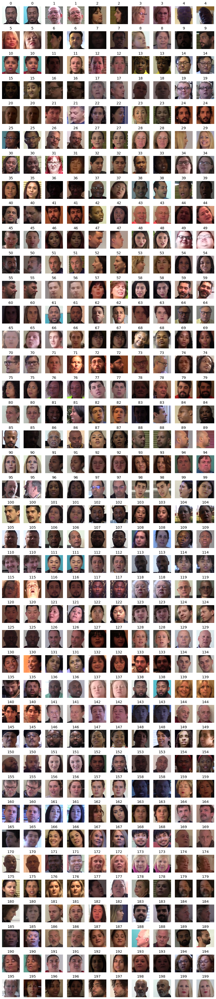

In [219]:
views = pd.concat([newdf[newdf['class']==i].sample(2) for i in range(200)])
show_faces2(views)

100%|██████████| 50/50 [00:00<00:00, 226.80it/s]


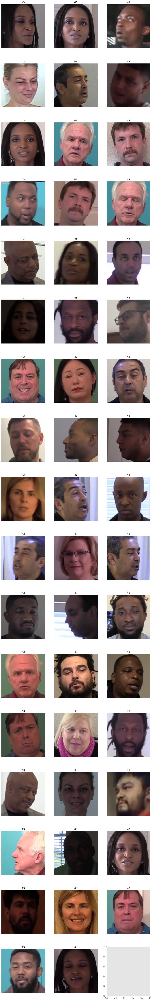

In [205]:
show_faces2(newdf[newdf['class']==43].sample(50))

In [210]:
newdf = gen_split(newdf, {i:[i] for i in labels})
len_train = len(newdf[newdf['split']=='train'])
len_val = len(newdf[newdf['split']=='validation'])
len_test = len(newdf[newdf['split']=='test'])
print(len_train, len_val, len_test)

15498 2807 566


In [211]:
print(len(newdf))
ret = newdf["class"].groupby(newdf["class"]).count()
# ret
ret[ret==ret.max()]

18871


class
43    2475
Name: class, dtype: int64

In [212]:
set_split(train_sample_metadata.index, "-1")

set_split(newdf[newdf['split']=='train'].index, "train")
set_split(newdf[newdf['split']=='validation'].index , "validation")
set_split(newdf[newdf['split']=='test'].index , "test")

train_sample_metadata['split_kailu'] = train_sample_metadata.apply(get_split, axis=1)

In [213]:
df = train_sample_metadata.copy()
df.head()

,label,original,person_num,split,split_kailu
aaqaifqrwn.mp4,FAKE,xugmhbetrw.mp4,1,train,train
aayrffkzxn.mp4,REAL,None,1,train,train
abhggqdift.mp4,FAKE,aayrffkzxn.mp4,1,train,train
acagallncj.mp4,FAKE,fzvpbrzssi.mp4,1,train,train
acdkfksyev.mp4,FAKE,qyqufaskjs.mp4,1,train,train


In [ ]:
def gen_class(row):
    try:
        if row.label=="REAL":
            return newdf.loc[row.name]["class"]
        else: 
            return newdf.loc[row.original]["class"]
    except:
        return -1
df['class'] = df.apply(gen_class , axis=1)

In [25]:
df.T.to_json(f'/data/deepfake/metadata/metadata_075.json')

# 结合一下提交结果

* my_inference(version 27/28)  0.66942
* 把预测值<0.5的改为0.5后  0.59305
* predict<0.5 比例约为 55%
* public LB 真假比例 1:1

In [28]:
x = (20*0.593 - 11*0.693)/9

In [31]:
y = (20*0.669 - 9*x)/11

In [32]:
x, y

(0.4707777777777778, 0.8311818181818182)

# More Information

* from https://arxiv.org/pdf/1910.08854.pdf we know that 74% female and 26% male; and 68% Caucasian, 20% African-American, 9% east-Asian, and 3% south-Asian
* Therefore, we initially filtered all videos by their average face size ratio, which measures the ratio of the maximum dimension of the face bounding boxes from a sampled set of frames to the minimum dimension of the video. All swaps were performed on videos where this measure was less than 0.25
* there's 1121 real video,  5214 total video from 66 actors in first batch of videos.
* You can use both JpegCompression and Downscale from Albumentations:

In [52]:
train_dir = "/data1/data/deepfake/dfdc_train/"
metadata = pd.read_json(os.path.join(train_dir, 'metadata_all.json') ).T
indexes = metadata.index

In [79]:
import cv2

metadata["shape"]=0
metadata["fps"]=0
metadata["shape"]=metadata["shape"].astype(object)
for fn in tqdm(indexes[:10]):
    vcap = cv2.VideoCapture(os.path.join(train_dir+fn))
    cv2.waitKey(20)
    if vcap.isOpened(): 
        width  = vcap.get(3) # float
        height = vcap.get(4) # float
        fps = vcap.get(cv2.CAP_PROP_FPS)
        metadata.at[fn,"shape"] = (int(width), int(height))
        metadata.at[fn,"fps"] = int(np.round(fps))
    else:
        print(f"open {fn} failed")
    vcap.release()

100%|██████████| 10/10 [00:00<00:00, 42.42it/s]


In [80]:
metadata

,label,original,split,shape,fps
aaqaifqrwn.mp4,FAKE,xugmhbetrw.mp4,train,"(1920, 1080)",30
aayrffkzxn.mp4,REAL,None,train,"(1080, 1920)",30
abhggqdift.mp4,FAKE,aayrffkzxn.mp4,train,"(1080, 1920)",30
acagallncj.mp4,FAKE,fzvpbrzssi.mp4,train,"(1080, 1920)",30
acdkfksyev.mp4,FAKE,qyqufaskjs.mp4,train,"(1080, 1920)",30
achdeirhym.mp4,FAKE,wynotylpnm.mp4,train,"(1080, 1920)",30
acryukkddn.mp4,FAKE,fsaronfupy.mp4,train,"(1080, 1920)",30
adftmlvzfs.mp4,FAKE,jawgcggquk.mp4,train,"(1080, 1920)",30
aegvtnwqoe.mp4,FAKE,ybnucgidtu.mp4,train,"(1080, 1920)",30
aejvkfbtxs.mp4,FAKE,eppyqpgewp.mp4,train,"(1080, 1920)",30
